In [1]:
import os,sys,inspect
currentdir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
parentdir = os.path.dirname(currentdir)
sys.path.insert(0,parentdir) 

In [1]:
import pandas as pd
import numpy as np
from bayesian.train_bn import structure_learning, parameter_learning, parameter_learning_mix, n_component
from preprocess.discretization import get_nodes_type, discretization, inverse_discretization, code_categories, get_nodes_sign
from bayesian.save_bn import save_structure, save_params, read_structure, read_params
from bayesian.sampling import generate_synthetics
from bayesian.subsample import get_subsample
from external.libpgm.hybayesiannetwork import HyBayesianNetwork
from visualization.visualization import draw_BN
from bayesian.calculate_accuracy import calculate_acc, LOO_validation
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from copy import copy
from external.libpgm.sampleaggregator import SampleAggregator
import operator
from sklearn.metrics import accuracy_score, mean_squared_error
from scipy import stats
from scipy.stats import multivariate_normal
from sklearn.mixture import GaussianMixture
import math
from pomegranate import DiscreteDistribution
import random
from sklearn.model_selection import train_test_split
from gmr import GMM
from sklearn.preprocessing import KBinsDiscretizer
import networkx as nx
from scipy.spatial.distance import cdist
from sklearn.linear_model import LogisticRegression

In [78]:
geo = pd.read_excel('DB.xlsx', sheet_name='Text')
geo.shape

<ipython-input-78-003f6639b767>:1: FutureWarning: Your version of xlrd is 1.2.0. In xlrd >= 2.0, only the xls format is supported. As a result, the openpyxl engine will be used if it is installed and the engine argument is not specified. Install openpyxl instead.
  geo = pd.read_excel('DB.xlsx', sheet_name='Text')


(1649, 252)

In [79]:
#geo = pd.read_csv('../data/geo3_1.csv')
columns = ['Period', 'Lithology', 'Structural setting', 'Oil density', 'Viscosity', 'Gas to oil ratio', 'Saturation pressure', 'FVF']
geo = geo[columns]
geo.dropna(inplace=True)
geo.reset_index(inplace=True, drop=True)
geo.shape

(344, 8)

In [80]:
geo['Structural setting'] = geo['Structural setting'].apply(lambda x: x.split('/')[0])

In [81]:
geo = geo.append({'Lithology':'SANDSTONE', 'Period': 'JURASSIC', 'Structural setting': 'WRENCH', 'Oil density': 815.5, 'Viscosity': 0.946857, 'Gas to oil ratio':97.5, 'Saturation pressure': 6.42,   'FVF': 1.23662}, ignore_index=True)

In [82]:
geo

,Period,Lithology,Structural setting,Oil density,Viscosity,Gas to oil ratio,Saturation pressure,FVF
0,CRETACEOUS,DOLOMITE,WRENCH,876.160991,12.000000,260.246260,32.460459,1.71300
1,CRETACEOUS,DOLOMITE,WRENCH,876.160991,7.200000,290.413910,31.371089,1.96800
2,CRETACEOUS,CHALKY LIMESTONE,FORELAND,904.153355,2.000000,66.262978,11.514224,1.25000
3,CRETACEOUS,CHALKY LIMESTONE,FORELAND,909.967846,27.000000,63.903115,11.376329,1.15000
4,CRETACEOUS,SANDSTONE,RIFT,822.674419,13.810000,182.064414,17.236862,1.50000
...,...,...,...,...,...,...,...,...
340,MESOZOIC,VOLCANICS,RIFT,870.769231,4.990000,46.543485,9.893959,1.16000
341,NEOGENE,DOLOMITE,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000
342,PERMIAN-CRETACEOUS,SANDSTONE,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000
343,PRECAMBRIAN,BASEMENT,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000


In [69]:
X_list = []
labels = []
for c1, c2 in zip(['Gross', 'Porosity', 'Depth', 'Oil recovery factor'], ['Netpay', 'Permeability', 'Oil density', 'NTG_comb']):
    labels.append([c1, c2])
    X = []
    for e1, e2 in zip(geo[c1].values, geo[c2].values):
        X.append([e1, e2])
    X_list.append(np.array(X))

Automatically created module for IPython interactive environment


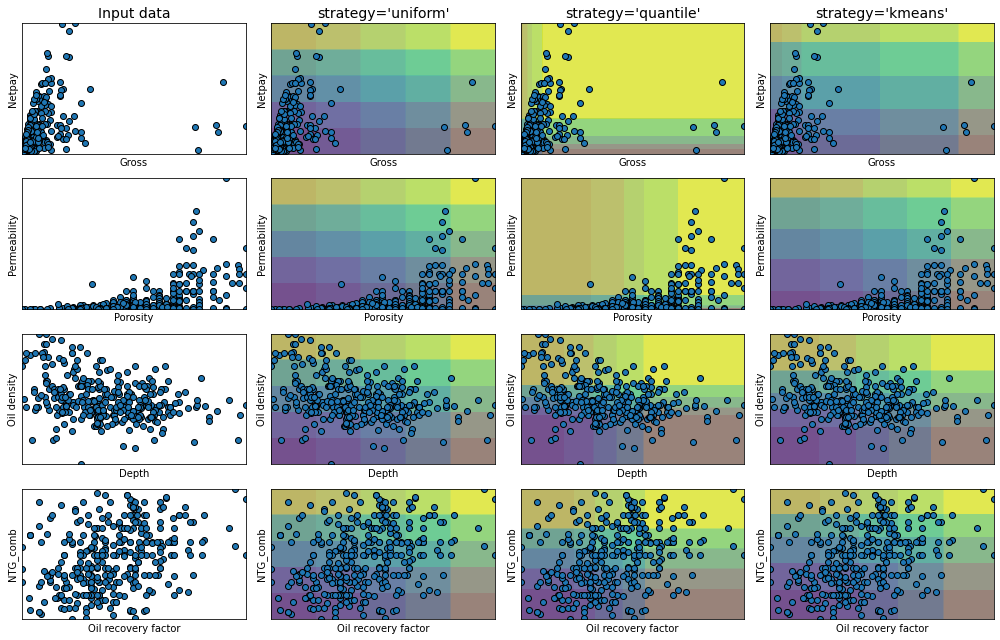

In [187]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.preprocessing import KBinsDiscretizer
from sklearn.datasets import make_blobs

print(__doc__)

strategies = ['uniform', 'quantile', 'kmeans']

# n_samples = 200
# centers_0 = np.array([[0, 0], [0, 5], [2, 4], [8, 8]])
# centers_1 = np.array([[0, 0], [3, 1]])

# # construct the datasets
# random_state = 42
# X_list = [
#     np.random.RandomState(random_state).uniform(-3, 3, size=(n_samples, 2)),
#     make_blobs(n_samples=[n_samples // 10, n_samples * 4 // 10,
#                           n_samples // 10, n_samples * 4 // 10],
#                cluster_std=0.5, centers=centers_0,
#                random_state=random_state)[0],
#     make_blobs(n_samples=[n_samples // 5, n_samples * 4 // 5],
#                cluster_std=0.5, centers=centers_1,
#                random_state=random_state)[0],
# ]

figure = plt.figure(figsize=(14, 9))
i = 1
for ds_cnt, X in enumerate(X_list):

    ax = plt.subplot(len(X_list), len(strategies) + 1, i)
    ax.scatter(X[:, 0], X[:, 1], edgecolors='k')
    if ds_cnt == 0:
        ax.set_title("Input data", size=14)

    xx, yy = np.meshgrid(
        np.linspace(X[:, 0].min(), X[:, 0].max(), 300),
        np.linspace(X[:, 1].min(), X[:, 1].max(), 300))
    grid = np.c_[xx.ravel(), yy.ravel()]

    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_xlabel(labels[ds_cnt][0])
    ax.set_ylabel(labels[ds_cnt][1])

    i += 1
    # transform the dataset with KBinsDiscretizer
    for strategy in strategies:
        enc = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy=strategy)
        enc.fit(X)
        grid_encoded = enc.transform(grid)

        ax = plt.subplot(len(X_list), len(strategies) + 1, i)

        # horizontal stripes
        horizontal = grid_encoded[:, 0].reshape(xx.shape)
        ax.contourf(xx, yy, horizontal, alpha=.5)
        # vertical stripes
        vertical = grid_encoded[:, 1].reshape(xx.shape)
        ax.contourf(xx, yy, vertical, alpha=.5)

        ax.scatter(X[:, 0], X[:, 1], edgecolors='k')
        ax.set_xlim(xx.min(), xx.max())
        ax.set_ylim(yy.min(), yy.max())
        ax.set_xticks(())
        ax.set_yticks(())
        ax.set_xlabel(labels[ds_cnt][0])
        ax.set_ylabel(labels[ds_cnt][1])
        if ds_cnt == 0:
            ax.set_title("strategy='%s'" % (strategy, ), size=14)

        i += 1

plt.tight_layout()
plt.show()

In [83]:
geo_types = get_nodes_type(geo)
geo_types

{'Period': 'disc',
 'Lithology': 'disc',
 'Structural setting': 'disc',
 'Oil density': 'cont',
 'Viscosity': 'cont',
 'Gas to oil ratio': 'cont',
 'Saturation pressure': 'cont',
 'FVF': 'cont'}

In [84]:
geo_signs = get_nodes_sign(geo)
geo_signs

{'Oil density': 'pos',
 'Viscosity': 'pos',
 'Gas to oil ratio': 'pos',
 'Saturation pressure': 'pos',
 'FVF': 'pos'}

In [85]:
colums_for_code = []
columns_for_disc = []
for c in columns:
    if geo_types[c] == 'disc':
        colums_for_code.append(c)
    else:
        columns_for_disc.append(c)

In [86]:
data_coded, code_dict = code_categories(geo, 'label', colums_for_code)
data_discrete, est = discretization(data_coded, 'kmeans', columns_for_disc)

In [145]:
_, code_dict = code_categories(geo, 'label', colums_for_code)

In [8]:
geo_train, geo_test = train_test_split(geo, test_size=0.2)
geo_train.reset_index(inplace=True, drop=True)
geo_test.reset_index(inplace=True, drop=True)

In [9]:
data_coded = copy(geo_train)
for c in colums_for_code:
    param_dict = code_dict[c]
    data_coded[c] = data_coded[c].apply(lambda x: param_dict[x])
data_discrete, est = discretization(data_coded, 'kmeans', columns_for_disc)
bn_structures = []
for i in range (geo_train.shape[0]):
    test = dict(geo_train.iloc[i,:])
    cluster = get_subsample(test, geo_train, 'gower', columns, 60)
    indexes = cluster.index.to_list()
    train_data = data_discrete.loc[indexes,:]
    train_data.reset_index(inplace=True, drop=True)
    bn = structure_learning(train_data, 'HC', geo_types, 'K2')
    G = nx.DiGraph()
    G.add_nodes_from(bn['V'])
    for edge in bn['E']:
        G.add_edge(edge[0], edge[1])
    bn_structures.append(G)

In [87]:
bn_structures = []
for i in range (geo.shape[0]):
    test = dict(geo.iloc[i,:])
    cluster = get_subsample(test, geo, 'gower', columns, 60)
    indexes = cluster.index.to_list()
    train_data = data_discrete.loc[indexes,:]
    train_data.reset_index(inplace=True, drop=True)
    bn = structure_learning(train_data, 'HC', geo_types, 'K2')
    G = nx.DiGraph()
    G.add_nodes_from(bn['V'])
    for edge in bn['E']:
        G.add_edge(edge[0], edge[1])
    bn_structures.append(G)

In [88]:
hamming_dist = [[0 for j in range(len(bn_structures))] for i in range(len(bn_structures))]
for i in range(len(bn_structures)):
    for j in range(len(bn_structures)):
        flatten1 = nx.adjacency_matrix(bn_structures[i], nodelist=sorted(bn_structures[i].nodes())).toarray().flatten()
        flatten2 = nx.adjacency_matrix(bn_structures[j], nodelist=sorted(bn_structures[j].nodes())).toarray().flatten()
        hamming_dist[i][j] = cdist([flatten1], [flatten2], metric='hamming')[0][0]

In [89]:
hamming_dist = np.array(hamming_dist)
hamming_dist

array([[0.      , 0.      , 0.140625, ..., 0.0625  , 0.03125 , 0.140625],
       [0.      , 0.      , 0.140625, ..., 0.0625  , 0.03125 , 0.140625],
       [0.140625, 0.140625, 0.      , ..., 0.140625, 0.140625, 0.15625 ],
       ...,
       [0.0625  , 0.0625  , 0.140625, ..., 0.      , 0.03125 , 0.109375],
       [0.03125 , 0.03125 , 0.140625, ..., 0.03125 , 0.      , 0.140625],
       [0.140625, 0.140625, 0.15625 , ..., 0.109375, 0.140625, 0.      ]])

C:\Users\anaxa\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\matrix.py:649: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
C:\Users\anaxa\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\matrix.py:619: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,


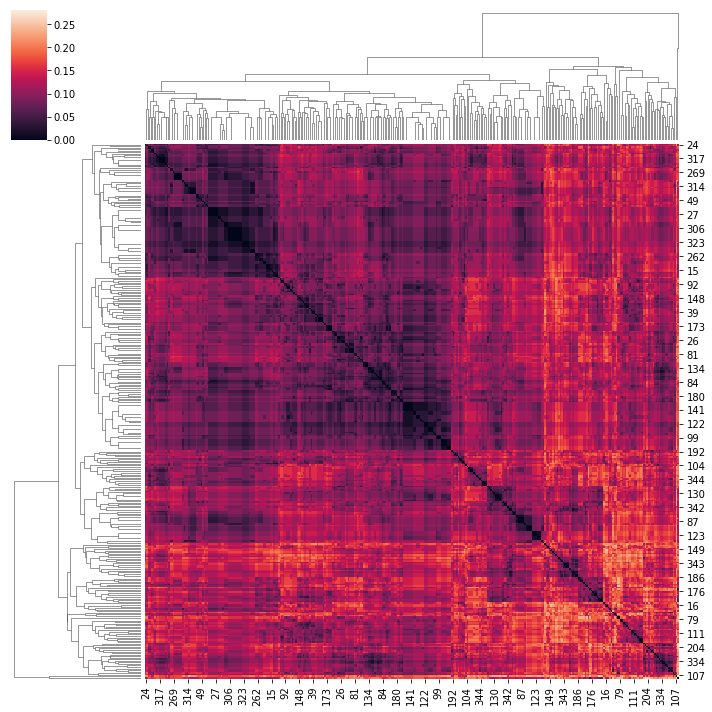

In [90]:
sns.clustermap(hamming_dist)

In [92]:
from sklearn.cluster import AgglomerativeClustering
clustering = AgglomerativeClustering(n_clusters=3,affinity='precomputed', linkage = 'complete').fit(hamming_dist)

In [50]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(random_state=0).fit(data_coded[['Period', 'Lithology', 'Structural setting', 'Oil density', 'Viscosity', 'Gas to oil ratio', 'Saturation pressure', 'FVF']], clustering.labels_)

In [93]:
geo['cluster'] = clustering.labels_
data_discrete['cluster'] = clustering.labels_

In [94]:
geo

,Period,Lithology,Structural setting,Oil density,Viscosity,Gas to oil ratio,Saturation pressure,FVF,cluster
0,CRETACEOUS,DOLOMITE,WRENCH,876.160991,12.000000,260.246260,32.460459,1.71300,2
1,CRETACEOUS,DOLOMITE,WRENCH,876.160991,7.200000,290.413910,31.371089,1.96800,2
2,CRETACEOUS,CHALKY LIMESTONE,FORELAND,904.153355,2.000000,66.262978,11.514224,1.25000,0
3,CRETACEOUS,CHALKY LIMESTONE,FORELAND,909.967846,27.000000,63.903115,11.376329,1.15000,0
4,CRETACEOUS,SANDSTONE,RIFT,822.674419,13.810000,182.064414,17.236862,1.50000,0
...,...,...,...,...,...,...,...,...,...
340,MESOZOIC,VOLCANICS,RIFT,870.769231,4.990000,46.543485,9.893959,1.16000,2
341,NEOGENE,DOLOMITE,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000,1
342,PERMIAN-CRETACEOUS,SANDSTONE,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000,2
343,PRECAMBRIAN,BASEMENT,SUB-SALT,854.984894,0.840000,140.147258,14.444490,1.28000,2


In [16]:
test_coded = copy(geo_test)
for c in colums_for_code:
    param_dict = code_dict[c]
    test_coded[c] = test_coded[c].apply(lambda x: param_dict[x])

In [17]:
test_discrete = copy(geo_test)
test_discrete[columns_for_disc] = est.transform(geo_test[columns_for_disc].values)

In [2]:
net1_data = pd.read_csv('cluster1.csv')
net2_data = pd.read_csv('cluster2.csv')
net3_data = pd.read_csv('cluster3.csv')

In [95]:
net1_data = geo.loc[geo['cluster'] == 0]
net1_data_discrete = data_discrete.loc[data_discrete['cluster'] == 0]
net1_data = net1_data.drop(columns='cluster')
net1_data_discrete = net1_data_discrete.drop(columns='cluster')
net2_data = geo.loc[geo['cluster'] == 1]
net2_data_discrete = data_discrete.loc[data_discrete['cluster'] == 1]
net2_data = net2_data.drop(columns='cluster')
net2_data_discrete = net2_data_discrete.drop(columns='cluster')
net3_data = geo.loc[geo['cluster'] == 2]
net3_data_discrete = data_discrete.loc[data_discrete['cluster'] == 2]
net3_data = net3_data.drop(columns='cluster')
net3_data_discrete = net3_data_discrete.drop(columns='cluster')

In [249]:
net1_data.to_csv('cluster1.csv', index=False)
net2_data.to_csv('cluster2.csv', index=False)
net3_data.to_csv('cluster3.csv', index=False)

In [96]:
net2_data.to_csv('cluster_watt.csv', index=False)

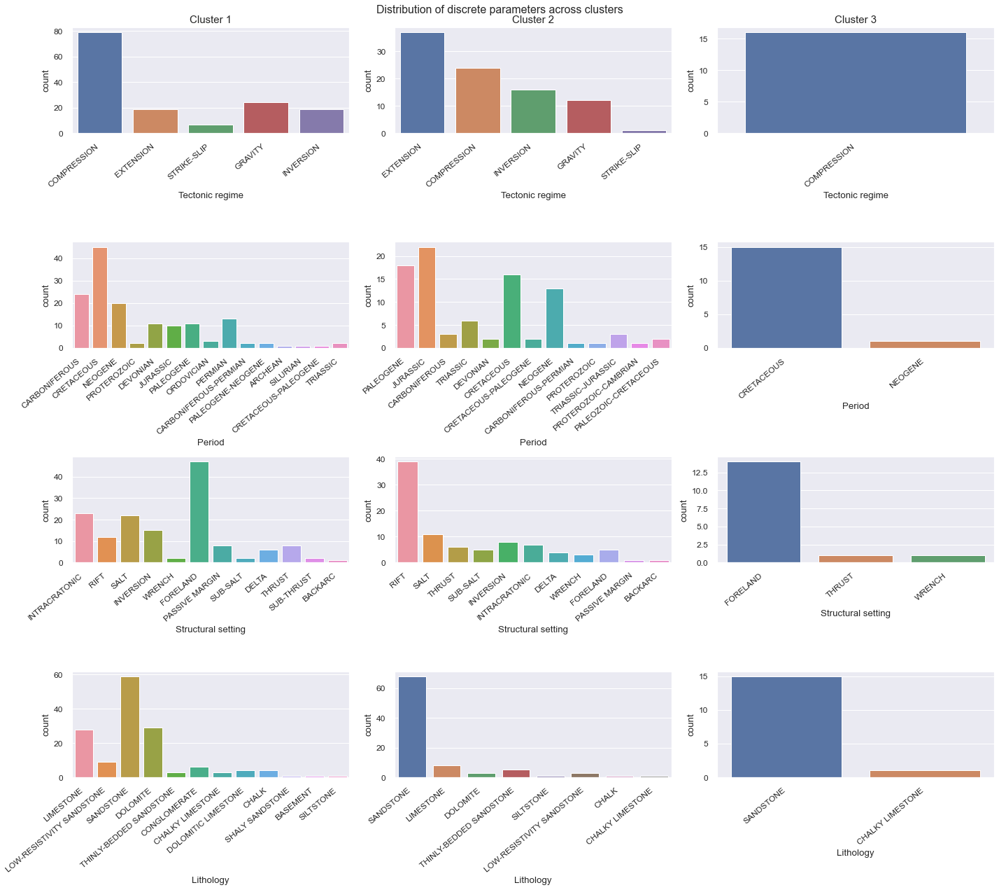

In [5]:
import matplotlib.style
import matplotlib as mpl
mpl.style.use('seaborn')
sns.set(font_scale=1.1)
fig, axes = plt.subplots(4, 3, figsize=(20, 18))
fig.suptitle('Distribution of discrete parameters across clusters')

sns.set(font_scale=1)  
sns.countplot(x='Tectonic regime', data=net1_data, ax = axes[0,0])
axes[0,0].set_title('Cluster 1', fontsize=15)
axes[0,0].set_xticklabels(axes[0,0].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[0,0].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Tectonic regime', data=net2_data, ax = axes[0,1])
axes[0,1].set_title('Cluster 2', fontsize=15)
axes[0,1].set_xticklabels(axes[0,1].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[0,1].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Tectonic regime', data=net3_data, ax = axes[0,2])
axes[0,2].set_title('Cluster 3', fontsize=15)
axes[0,2].set_xticklabels(axes[0,2].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[0,2].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Period', data=net1_data, ax = axes[1,0])
axes[1,0].set_xticklabels(axes[1,0].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[1,0].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Period', data=net2_data, ax = axes[1,1])
axes[1,1].set_xticklabels(axes[1,1].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[1,1].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Period', data=net3_data, ax = axes[1,2])
axes[1,2].set_xticklabels(axes[1,2].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[1,2].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Structural setting', data=net1_data, ax = axes[2,0])
axes[2,0].set_xticklabels(axes[2,0].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[2,0].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Structural setting', data=net2_data, ax = axes[2,1])
axes[2,1].set_xticklabels(axes[2,1].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[2,1].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Structural setting', data=net3_data, ax = axes[2,2])
axes[2,2].set_xticklabels(axes[2,2].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[2,2].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Lithology', data=net1_data, ax = axes[3,0])
axes[3,0].set_xticklabels(axes[3,0].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[3,0].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Lithology', data=net2_data, ax = axes[3,1])
axes[3,1].set_xticklabels(axes[3,1].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[3,1].tick_params(labelsize=12)
plt.tight_layout()
sns.countplot(x='Lithology', data=net3_data, ax = axes[3,2])
axes[3,2].set_xticklabels(axes[3,2].get_xticklabels(), fontsize=7, rotation=40, ha="right")
axes[3,2].tick_params(labelsize=12)
plt.tight_layout()

C:\Users\anaxa\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='NTG_comb'>

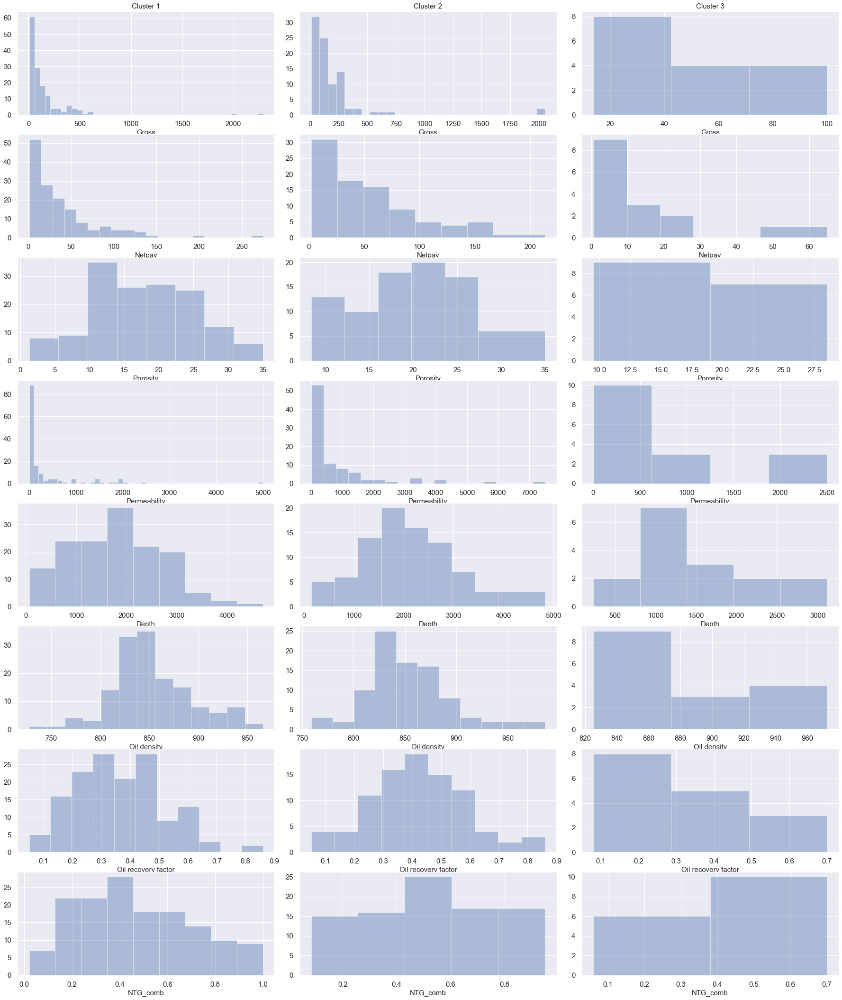

In [22]:
fig, axes = plt.subplots(8, 3, figsize=(25, 29))
#fig.suptitle('Distribution of continuous parameters across clusters')
fig.tight_layout()

sns.set(font_scale=1.1)  
sns.distplot(net1_data['Gross'], ax = axes[0,0], kde=False)
axes[0,0].set_title('Cluster 1', fontsize=15)
axes[0,0].tick_params(labelsize=15)
axes[0,0].set_xlabel('Gross', fontsize=15)
axes[0,1].tick_params(labelsize=15)
axes[0,1].set_xlabel('Gross', fontsize=15)
axes[0,2].tick_params(labelsize=15)
axes[0,2].set_xlabel('Gross', fontsize=15)
axes[1,0].tick_params(labelsize=15)
axes[1,0].set_xlabel('Netpay', fontsize=15)
axes[1,1].tick_params(labelsize=15)
axes[1,1].set_xlabel('Netpay', fontsize=15)
axes[1,2].tick_params(labelsize=15)
axes[1,2].set_xlabel('Netpay', fontsize=15)
axes[2,0].tick_params(labelsize=15)
axes[2,0].set_xlabel('Porosity', fontsize=15)
axes[2,1].tick_params(labelsize=15)
axes[2,1].set_xlabel('Porosity', fontsize=15)
axes[2,2].tick_params(labelsize=15)
axes[2,2].set_xlabel('Porosity', fontsize=15)
axes[3,0].tick_params(labelsize=15)
axes[3,0].set_xlabel('Permeability', fontsize=15)
axes[3,1].tick_params(labelsize=15)
axes[3,1].set_xlabel('Permeability', fontsize=15)
axes[3,2].tick_params(labelsize=15)
axes[3,2].set_xlabel('Permeability', fontsize=15)
axes[4,0].tick_params(labelsize=15)
axes[4,0].set_xlabel('Depth', fontsize=15)
axes[4,1].tick_params(labelsize=15)
axes[4,1].set_xlabel('Depth', fontsize=15)
axes[4,2].tick_params(labelsize=15)
axes[4,2].set_xlabel('Depth', fontsize=15)
axes[5,0].tick_params(labelsize=15)
axes[5,0].set_xlabel('Oil density', fontsize=15)
axes[5,1].tick_params(labelsize=15)
axes[5,1].set_xlabel('Oil density', fontsize=15)
axes[5,2].tick_params(labelsize=15)
axes[5,2].set_xlabel('Oil density', fontsize=15)
axes[6,0].tick_params(labelsize=15)
axes[6,0].set_xlabel('Oil recovery factor', fontsize=15)
axes[6,1].tick_params(labelsize=15)
axes[6,1].set_xlabel('Oil recovery factor', fontsize=15)
axes[6,2].tick_params(labelsize=15)
axes[6,2].set_xlabel('Oil recovery factor', fontsize=15)
axes[7,0].tick_params(labelsize=15)
axes[7,0].set_xlabel('NTG_comb', fontsize=15)
axes[7,1].tick_params(labelsize=15)
axes[7,1].set_xlabel('NTG_comb', fontsize=15)
axes[7,2].tick_params(labelsize=15)
axes[7,2].set_xlabel('NTG_comb', fontsize=15)


sns.distplot(net2_data['Gross'], ax = axes[0,1], kde=False)
axes[0,1].set_title('Cluster 2', fontsize=15)
sns.distplot(net3_data['Gross'], ax = axes[0,2], kde=False)
axes[0,2].set_title('Cluster 3', fontsize=15)
sns.distplot( net1_data['Netpay'], ax = axes[1,0], kde=False)
sns.distplot(net2_data['Netpay'], ax = axes[1,1], kde=False)
sns.distplot(net3_data['Netpay'], ax = axes[1,2], kde=False)
sns.distplot(net1_data['Porosity'], ax = axes[2,0], kde=False)
sns.distplot(net2_data['Porosity'], ax = axes[2,1], kde=False)
sns.distplot(net3_data['Porosity'], ax = axes[2,2], kde=False)
sns.distplot(net1_data['Permeability'], ax = axes[3,0], kde=False)
sns.distplot(net2_data['Permeability'], ax = axes[3,1], kde=False)
sns.distplot(net3_data['Permeability'], ax = axes[3,2], kde=False)
sns.distplot(net1_data['Depth'], ax = axes[4,0], kde=False)
sns.distplot(net2_data['Depth'], ax = axes[4,1], kde=False)
sns.distplot(net3_data['Depth'], ax = axes[4,2], kde=False)
sns.distplot(net1_data['Oil density'], ax = axes[5,0], kde=False)
sns.distplot(net2_data['Oil density'], ax = axes[5,1], kde=False)
sns.distplot(net3_data['Oil density'], ax = axes[5,2], kde=False)
sns.distplot(net1_data['Oil recovery factor'], ax = axes[6,0], kde=False)
sns.distplot(net2_data['Oil recovery factor'], ax = axes[6,1], kde=False)
sns.distplot(net3_data['Oil recovery factor'], ax = axes[6,2], kde=False)
sns.distplot(net1_data['NTG_comb'], ax = axes[7,0], kde=False)
sns.distplot(net2_data['NTG_comb'], ax = axes[7,1], kde=False)
sns.distplot(net3_data['NTG_comb'], ax = axes[7,2], kde=False)

In [96]:
bn_full = structure_learning(net1_data_discrete, 'HC', geo_types, 'K2')
params = parameter_learning(net1_data, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
net1 = HyBayesianNetwork(skel, params)

In [97]:
draw_BN(bn_full, geo_types, 'cluster1')

In [98]:
bn_full = structure_learning(net2_data_discrete, 'HC', geo_types, 'K2')
params = parameter_learning(net2_data, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
net2 = HyBayesianNetwork(skel, params)

In [99]:
draw_BN(bn_full, geo_types, 'cluster2')

In [100]:
bn_full = structure_learning(net3_data_discrete, 'HC', geo_types, 'K2')
params = parameter_learning(net3_data, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
net3 = HyBayesianNetwork(skel, params)

In [101]:
draw_BN(bn_full, geo_types, 'cluster3')

In [29]:
acc, rmse, real, pred = calculate_acc(all_bn, geo_test, columns, 'simple')

"['CAMBRIAN-ORDOVICIAN/CARBONIFEROUS']"
"['CAMBRIAN']"
"['VOLCANICS']"
"['MESOZOIC']"
"['VOLCANICS']"
"['PERMIAN-TRIASSIC']"


In [30]:
acc

{'Tectonic regime': 0.81,
 'Period': 0.25,
 'Lithology': 0.58,
 'Structural setting': 0.4}

In [31]:
rmse

{'Gross': 0.18,
 'Netpay': 0.23,
 'Porosity': 0.17,
 'Permeability': 0.23,
 'Depth': 0.25,
 'Oil density': 0.2,
 'Oil recovery factor': 0.23,
 'NTG_comb': 0.26}

In [32]:
test_labels = clf.predict(test_coded)
test_labels

array([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0,
       0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 1],
      dtype=int64)

In [33]:
pred_by_cluster = [[0 for j in range(geo_test.shape[0])] for i in range(len(columns))]
real_by_cluster = [[0 for j in range(geo_test.shape[0])] for i in range(len(columns))]
for i in range(geo_test.shape[0]):
    unit = dict(geo_test.iloc[i,:])
    for n, key in enumerate(columns):
        train = copy(unit)
        train.pop(key)
        sample = []
        try:
            if test_labels[i] == 0:
                sample = generate_synthetics(net1, geo_signs, 'simple', 2000, train)
            if test_labels[i] == 1:
                sample = generate_synthetics(net2, geo_signs, 'simple', 2000, train)
            if test_labels[i] == 2:
                sample = generate_synthetics(net3, geo_signs, 'simple', 2000, train)
            if geo_types[key] == 'disc':
                pred_by_cluster[n][i] = sample[key].mode()[0]
                real_by_cluster[n][i] = unit[key]
            if geo_types[key] == 'cont':
                if sample.shape[0] == 0:
                    pred_by_cluster[n][i] = np.nan
                    real_by_cluster[n][i] = np.nan
                else:
                    pred_by_cluster[n][i] = sample[key].mean()
                    real_by_cluster[n][i] = unit[key]
        except:
            pred_by_cluster[n][i] = np.nan
            real_by_cluster[n][i] = np.nan

        
        

In [34]:
for l in range(len(columns)):
    pred_by_cluster[l] = [element for element in pred_by_cluster[l] if str(element) != 'nan']
    real_by_cluster[l] = [element for element in real_by_cluster[l] if str(element) != 'nan']

In [35]:
accuracy_dict = dict()
rmse_dict = dict()

In [36]:
for n, key in enumerate(columns):
    if geo_types[key] == 'disc':
        accuracy_dict[key] = round(accuracy_score(real_by_cluster[n], pred_by_cluster[n]),2)
    if geo_types[key] == 'cont':
        rmse_dict[key] = round(mean_squared_error(real_by_cluster[n], pred_by_cluster[n], squared=False) / (np.max(real_by_cluster[n]) - np.min(real_by_cluster[n])), 2)

In [37]:
accuracy_dict

{'Tectonic regime': 0.78,
 'Period': 0.33,
 'Lithology': 0.58,
 'Structural setting': 0.49}

In [38]:
rmse_dict

{'Gross': 0.18,
 'Netpay': 0.22,
 'Porosity': 0.21,
 'Permeability': 0.19,
 'Depth': 0.24,
 'Oil density': 0.19,
 'Oil recovery factor': 0.23,
 'NTG_comb': 0.22}

In [15]:
columns = []
for i in range(len(bn_structures)):
        columns.append('Reservoir '+ str(i))

In [17]:
hamming_df = pd.DataFrame(columns=columns)
for n, element in enumerate(hamming_dist):
    hamming_df['Reservoir '+ str(n)] = element

In [19]:
hamming_df.index = columns

In [25]:
geo_train = geo_train.drop(columns=['cluster'])

In [211]:
geo_coded, label_coder = code_categories(geo, 'label', colums_for_code)
geo_discrete, coder = discretization(geo_coded, 'kmeans', columns_for_disc)
#geo_only_discrete, discrete_coder = discretization(geo, 'equal_frequency', columns_for_disc)

In [212]:
bn_full = structure_learning(geo_discrete, 'HC', geo_types, 'K2')

In [213]:
params = parameter_learning(geo_train, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
all_bn = HyBayesianNetwork(skel, params)

In [17]:
target_unit = {'Lithology':'SANDSTONE', 'Period': 'JURASSIC', 'Structural setting': 'WRENCH', 'Gross': 160, 'Netpay': 120, 'Permeability': 221, 'Porosity': 17, 'Depth': 1566, 'Oil density': 815.5, 'NTG_comb': 0.76}

In [ ]:
'Period', 'Lithology', 'Structural setting', 'Oil density', 'Viscosity', 'Gas to oil ratio', 'Saturation pressure', 'FVF'

In [52]:
code_dict['Lithology']

{'BASEMENT': 0,
 'CHALK': 1,
 'CHALKY LIMESTONE': 2,
 'CHERT': 3,
 'CONGLOMERATE': 4,
 'DOLOMITE': 5,
 'DOLOMITIC LIMESTONE': 6,
 'LIMESTONE': 7,
 'LOW-RESISTIVITY SANDSTONE': 8,
 'SANDSTONE': 9,
 'SHALE': 10,
 'SHALY SANDSTONE': 11,
 'SILICEOUS SHALE': 12,
 'SILTSTONE': 13,
 'THINLY-BEDDED SANDSTONE': 14,
 'VOLCANICS': 15}

In [18]:
coded_target = np.transpose([11, 9, 11, 160, 120, 17, 221, 1566, 815.5, 0.76])

In [19]:
clf.predict([coded_target])

array([1], dtype=int64)

In [244]:
sample_all_bn  = generate_synthetics(all_bn, geo_signs, 'simple', 2000, target_unit)

In [132]:
mean_confidence_interval(rf['Oil recovery factor'].values)

(0.3844111141243324, 0.34008197560732134, 0.4287402526413434)

In [246]:
sample_cluster_1 = generate_synthetics(net2, geo_signs, 'simple', 2000, target_unit)

In [136]:
mean_confidence_interval(sample_cluster_1['Oil recovery factor'].values)

(0.4079230095169557, 0.36590639256312274, 0.44993962647078867)

In [181]:
phis_model = pd.read_csv('../data/general_table.csv')
round(phis_model['RF'].mean(), 2)

0.44

In [122]:
def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), stats.sem(a)
    h = se * stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h

In [125]:
mean_confidence_interval(phis_model['RF'].values)

(0.44499923076923076, 0.43129688871429656, 0.45870157282416496)

In [195]:
params = ['Lithology', 'Period', 'Structural setting', 'Gross','Netpay','Porosity','Permeability', 'Depth', 'Oil density', 'NTG_comb']

In [196]:
analogs = get_subsample(target_unit, geo, 'hamming', params, 60)

In [197]:
geo_coded_analogs, label_coder = code_categories(analogs, 'label', colums_for_code)
geo_discrete_analogs, coder = discretization(geo_coded_analogs, 'kmeans', columns_for_disc)

In [198]:
bn_full = structure_learning(geo_discrete_analogs, 'HC', geo_types, 'K2')

In [199]:
params = parameter_learning(analogs, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
all_bn = HyBayesianNetwork(skel, params)

In [188]:
sample_cosine = generate_synthetics(all_bn, geo_signs, 'simple', 53)

In [194]:
sample_gower= generate_synthetics(all_bn, geo_signs, 'simple', 53)

In [200]:
sample_hamming= generate_synthetics(all_bn, geo_signs, 'simple', 53)

In [230]:
sns.color_palette("dark:salmon_r", as_cmap=True)

Text(0.5, 1.0, 'BN on filtering cluster')

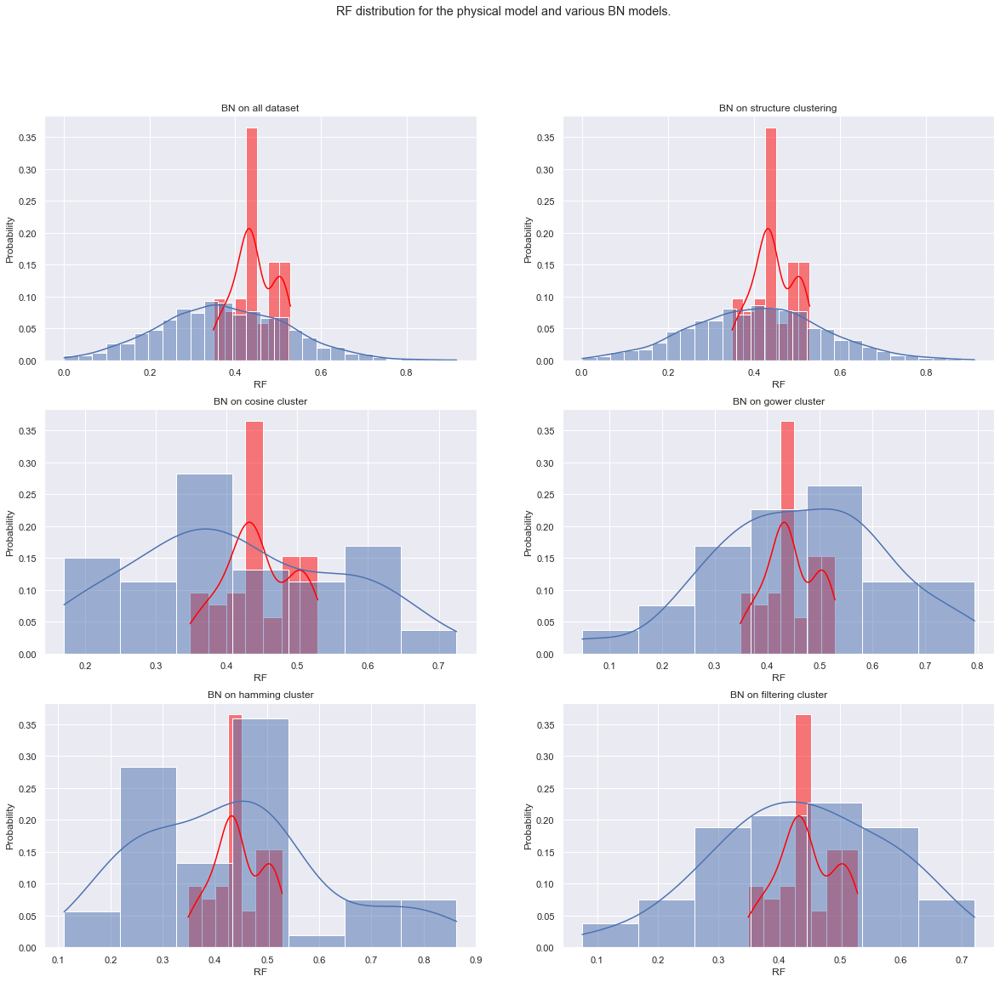

In [247]:
fig, axes = plt.subplots(3, 2, figsize=(20, 18))
fig.suptitle('RF distribution for the physical model and various BN models.')


sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[0,0], color='red')
sns.histplot(sample_all_bn['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[0,0])
axes[0,0].set_title('BN on all dataset')


sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[0,1], color='red')
sns.histplot(sample_cluster_1['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[0,1])
axes[0,1].set_title('BN on structure clustering')

sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[1,0], color='red')
sns.histplot(sample_cosine['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[1,0])
axes[1,0].set_title('BN on cosine cluster')

sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[1,1], color='red')
sns.histplot(sample_gower['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[1,1])
axes[1,1].set_title('BN on gower cluster')

sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[2,0], color='red')
sns.histplot(sample_hamming['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[2,0])
axes[2,0].set_title('BN on hamming cluster')

sns.histplot(phis_model['RF'], stat='probability',kde=True, ax = axes[2,1], color='red')
sns.histplot(sample['Oil recovery factor'],stat='probability' ,kde=True, ax=axes[2,1])
axes[2,1].set_title('BN on filtering cluster')

In [171]:
mean_confidence_interval(sample['Oil recovery factor'].values)

(0.4555507150878046, 0.40445375813765033, 0.5066476720379588)

In [12]:
sample = generate_synthetics(all_bn, geo_signs, 'simple', 400, evidence={'Lithology':'SANDSTONE', 'Period': 'JURASSIC', 'Structural setting': 'WRENCH', 'Gross': 160, 'Netpay': 120, 'Permeability': 221, 'Porosity': 17, 'Depth': 1566, 'Oil density': 815.5})

In [129]:
sample_watt = geo.loc[(geo['Oil recovery factor'] > 0.25) & (geo['Oil recovery factor'] < 0.27)]

In [37]:
def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), stats.sem(a)
    h = se * stats.t.ppf((1 + confidence) / 2., n-1)
    return round(m, 3), round(m-h,3), round(m+h,3)

In [141]:
mean_confidence_interval(sample['Oil recovery factor'].values)

(0.388, 0.376, 0.401)

C:\Users\anaxa\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\anaxa\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Oil recovery factor', ylabel='Density'>

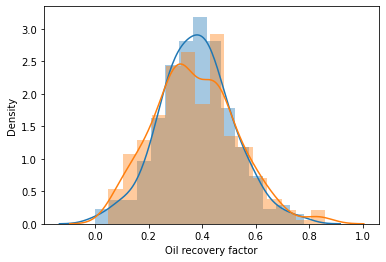

In [28]:
sns.distplot(sample['Oil recovery factor'])
sns.distplot(geo['Oil recovery factor'])

In [10]:
acc, rmse, real, pred = calculate_acc(all_bn, geo, columns, 'mix')

In [11]:
acc

{'Tectonic regime': 0.81,
 'Period': 0.35,
 'Lithology': 0.58,
 'Structural setting': 0.44,
 'Depositional environment': 0.21}

In [12]:
rmse

{'Gross': 440.5,
 'Netpay': 30.24,
 'Porosity': 5.71,
 'Permeability': 704.36,
 'Depth': 406.73,
 'Oil density': 14.51,
 'Oil recovery factor': 0.14}

In [13]:
params = parameter_learning(geo, geo_types, bn_full, 'simple')
save_structure(bn_full, 'all_net')
skel = read_structure('all_net')
save_params(params, 'all_net_param')
params = read_params('all_net_param')
all_bn = HyBayesianNetwork(skel, params)

In [14]:
acc, rmse, real, pred = calculate_acc(all_bn, geo, columns, 'simple')

In [15]:
acc

{'Tectonic regime': 0.81,
 'Period': 0.34,
 'Lithology': 0.58,
 'Structural setting': 0.44,
 'Depositional environment': 0.23}

In [16]:
rmse

{'Gross': 483.91,
 'Netpay': 31.56,
 'Porosity': 5.71,
 'Permeability': 799.65,
 'Depth': 465.71,
 'Oil density': 21.7,
 'Oil recovery factor': 0.15}